# Dependencies

In [4]:
pip install tensorflow

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [6]:
pip install --upgrade pip

Defaulting to user installation because normal site-packages is not writeable
     ---------------------------------------- 2.1/2.1 MB 4.6 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2
Note: you may need to restart the kernel to use updated packages.


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


In [9]:
pip install tensorflow-addons

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for tensorflow-addons from https://files.pythonhosted.org/packages/2e/24/67281758c14d3c5c79b6823b919f80eb1568c887ded99e9570ce627f32b5/tensorflow_addons-0.21.0-cp310-cp310-win_amd64.whl.metadata
   ---------------------------------------- 719.8/719.8 kB 7.6 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [1]:
import tensorflow as tf
from tensorflow import keras
 
from tensorflow.nn import depth_to_space
from tensorflow.nn import space_to_depth
from tensorflow.nn import softmax
from tensorflow.linalg import matmul
from tensorflow.math import divide
from tensorflow.math import sqrt
from tensorflow.math import add
from tensorflow.math import subtract
from tensorflow.image import extract_patches
 
from tensorflow.keras.layers import Conv2D 
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.preprocessing.image import ImageDataGenerator
 
from tensorflow_addons.image import median_filter2d
    
import os
import cv2
from skimage.util import random_noise

C:\Users\NIKHIL\AppData\Roaming\Python\Python310\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


# Dataset Preparation

In [7]:
# the training and test datasets for an image processing that is used for train and evaluating  an image processing model
batch_size = 1
image_size = 512
patch_size = 32
train_len = len(os.listdir('D:/Interns/upscalepics/DIV2K_train_HR'))
test_len = len(os.listdir('D:/Interns/upscalepics/DIV2K_valid_HR'))

datagen = ImageDataGenerator()

train_dataset = datagen.flow_from_directory('D:/Interns/upscalepics', target_size=(image_size, image_size), batch_size=batch_size, class_mode=None, classes=['DIV2K_train_HR'], color_mode='grayscale')
test_dataset = datagen.flow_from_directory('D:/Interns/upscalepics', target_size=(image_size, image_size), batch_size=batch_size, class_mode=None, classes=['DIV2K_valid_HR'], color_mode='grayscale')

Found 800 images belonging to 1 classes.
Found 100 images belonging to 1 classes.


## convolution network

In [120]:
#conv pathes the network
class Patch(keras.layers.Layer):
  def __init__(self, patch_size=32):
    super(Patch, self).__init__()
    self.patch_size = patch_size
 
  def call(self, images):
    channels = tf.shape(images)[-1]
    patches = tf.image.extract_patches(
        images=images, 
        sizes=[1, self.patch_size, self.patch_size, 1], 
        strides=[1, self.patch_size, self.patch_size, 1], 
        rates=[1, 1, 1, 1], padding="VALID"
        )
    patches = tf.reshape(patches, [-1, self.patch_size, self.patch_size, channels])
    return patches
 
 
# TODO: Needs Rework
# Noise Addition
class Noise(keras.layers.Layer):
  def __init__(self, ratio=0.5):
    super(Noise, self).__init__()
    self.ratio = ratio

  def call(self, inputs, training=None):
    size = inputs.shape
    mask_select = tf.keras.backend.random_bernoulli(shape=size, p=self.ratio, dtype=tf.float32)
    mask_noise = tf.keras.backend.random_bernoulli(shape=size, p=0.5, dtype=tf.float32)
    output = inputs * (1-mask_select) + (mask_noise * mask_select * 255)
    output = tf.clip_by_value(output, 0.0, 255.0)
    return output

import os
import IPython
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, add

# Rest of the code remains the same as in your provided code.

# Residual Layer
class Residual(keras.layers.Layer):
    def __init__(self, filter=32, kernel=(3,3), stride=(1,1), n_conv=2):
        super(Residual, self).__init__()
        self.filter = filter
        self.kernel = kernel
        self.stride = stride
        self.n_conv = n_conv

    def build(self, input_shape):
        self.convs = [Conv2D(self.filter, self.kernel, self.stride, padding='same', activation='relu') for _ in range(self.n_conv)]
        self.projection = Conv2D(self.filter, (1, 1), padding='same', activation='relu')

    def call(self, inputs):
        if inputs.shape[-1] == 1:  # Check if input is single-channel grayscale
            out = tf.image.grayscale_to_rgb(inputs)  # Convert single-channel grayscale to RGB
        else:
            out = inputs
        for conv in self.convs:
            out = conv(out)
        if inputs.shape[-1] != out.shape[-1]:
            out = self.projection(out)
        out = add([inputs, out])
        return out

## Encoder block

In [121]:

# Encoder Block
class EncoderBlock(keras.layers.Layer):
    def __init__(self, filter):
        super(EncoderBlock, self).__init__()
        self.filter = filter

    def build(self, input_shape):
        self.residual = Residual(filter=self.filter)
        self.downscale = Conv2D(self.filter, (3, 3), (2, 2), padding='same', activation='relu')

    def call(self, inputs):
        out = self.residual(inputs)
        out = tf.image.rgb_to_grayscale(out)  # Convert RGB to single-channel grayscale
        out = median_filter2d(out)
        out = self.downscale(out)
        return out

In [ ]:
class EncoderBlock(keras.layers.Layer):
    def __init__(self, filter):
        super(EncoderBlock, self).__init__()
        self.filter = filter
        
    def build(self, input_shape):
        self.residual = Residual(filter=self.filter)
        self.downscale = Conv2D(self.filter, (3,3), (2,2), padding='same', activation='relu')
        
    def call(self, inputs):
        out = self.residual(inputs)
        out = median_filter2d(out)
        out = self.downscale(out)
        return out

class Encoder(keras.Model):
    def __init__(self, init_filter=16, n_layers=4):
        super(Encoder, self).__init__()
        self.blocks = [EncoderBlock(init_filter*(i+1)) for i in range(n_layers)]

    def call(self, inputs):
        out = inputs
        for block in self.blocks:
            out = block(out)
        return out

## Decoder Block

In [ ]:

class DecoderBlock(keras.layers.Layer):
    def __init__(self, filter):
        super(DecoderBlock, self).__init__()
        self.filter = filter

    def build(self, input_shape):
        self.residual = Residual(filter=self.filter)
        self.upscale = Conv2DTranspose(self.filter, (3, 3), (2, 2), padding='same', activation='relu')

    def call(self, inputs):
        out = self.residual(inputs)
        out = tf.image.grayscale_to_rgb(out)  # Convert single-channel grayscale to RGB
        out = self.upscale(out)
        return out

In [ ]:
class DecoderBlock(keras.layers.Layer):
    def __init__(self, filter):
        super(DecoderBlock, self).__init__()
        self.filter = filter
        
    def build(self, input_shape):
        self.residual = Residual(filter=self.filter)
        self.upscale = Conv2DTranspose(self.filter, (3,3), (2,2), padding='same', activation='relu')
        
    def call(self, inputs):
        out = self.residual(inputs)
        out = self.upscale(out)
        return out

class Decoder(keras.Model):
    def __init__(self, init_filter=16, n_layers=4):
        super(Decoder, self).__init__()
        self.blocks = [DecoderBlock(init_filter*n_layers*(i/n_layers)) for i in range(n_layers, 0, -1)]

    def call(self, inputs):
        out = inputs
        for block in self.blocks:
            out = block(out)
        return out

## AutoEncoder

In [ ]:

class AutoEncoder(keras.Model):
    def __init__(self, init_filter=16, n_layers=4):
        super(AutoEncoder, self).__init__()
        self.encoder = Encoder(init_filter, n_layers)
        self.decoder = Decoder(init_filter, n_layers)
        self.projection = Conv2D(1, (3, 3), (1, 1), padding='same')  # Output single-channel grayscale

    def call(self, inputs):
        out = median_filter2d(inputs)
        out = self.encoder(out)
        out = self.decoder(out)
        out = self.projection(out)
        return out



# Hyperparameter

In [122]:
# TODO: Loss function  
# Training loop
def train_step(batch, model):
  image_clean = Patch(patch_size=patch_size)(batch) / 255.0
  image_noise = Patch(patch_size=patch_size)(Noise(ratio=0.5)(batch)) / 255.0
 
  with tf.GradientTape() as tape:
    logits = model(image_noise)
    loss = tf.keras.losses.MSE(image_clean, logits)
    
  grads = tape.gradient(loss, model.trainable_weights)
  optimizer.apply_gradients(zip(grads, model.trainable_weights))
  return loss
 
def train(epochs, dataset, model):
  for epoch in range(epochs):
    print('EPOCH:', epoch+1)
    for step, batch in enumerate(dataset):
      if step % 10 == 0: print('STEP:', step)
      loss = train_step(batch, model)
      if step >= train_len/batch_size:
        break

In [13]:
#training the model
model = AutoEncoder(init_filter=16, n_layers=3)
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
train(5, test_dataset, model)

EPOCH: 1
STEP: 0
STEP: 10
STEP: 20
STEP: 30
STEP: 40
STEP: 50
STEP: 60
STEP: 70
STEP: 80
STEP: 90
STEP: 100
STEP: 110
STEP: 120
STEP: 130
STEP: 140
STEP: 150
STEP: 160
STEP: 170
STEP: 180
STEP: 190
STEP: 200
STEP: 210
STEP: 220
STEP: 230
STEP: 240
STEP: 250
STEP: 260
STEP: 270
STEP: 280
STEP: 290
STEP: 300
STEP: 310
STEP: 320
STEP: 330
STEP: 340
STEP: 350
STEP: 360
STEP: 370
STEP: 380
STEP: 390
STEP: 400
STEP: 410
STEP: 420
STEP: 430
STEP: 440
STEP: 450
STEP: 460
STEP: 470
STEP: 480
STEP: 490
STEP: 500
STEP: 510
STEP: 520
STEP: 530
STEP: 540
STEP: 550
STEP: 560
STEP: 570
STEP: 580
STEP: 590
STEP: 600
STEP: 610
STEP: 620
STEP: 630
STEP: 640
STEP: 650
STEP: 660
STEP: 670
STEP: 680
STEP: 690
STEP: 700
STEP: 710
STEP: 720
STEP: 730
STEP: 740
STEP: 750
STEP: 760
STEP: 770
STEP: 780
STEP: 790
STEP: 800
EPOCH: 2
STEP: 0
STEP: 10
STEP: 20
STEP: 30
STEP: 40
STEP: 50
STEP: 60
STEP: 70
STEP: 80
STEP: 90
STEP: 100
STEP: 110
STEP: 120
STEP: 130
STEP: 140
STEP: 150
STEP: 160
STEP: 170
STEP: 180
STEP

# prediction 

In [123]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
 
def imshow(img):
    import cv2
    import IPython
    import numpy as np
    _,ret = cv2.imencode('.jpg', np.array(img)) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)
    
image_count = 1
image_size = 1024
image_index = 10
amount = 0.5

image = tf.expand_dims(tf.keras.preprocessing.image.img_to_array(
    tf.keras.preprocessing.image.load_img('D:/Interns/upscalepics/DIV2K_train_HR/' + os.listdir('D:/Interns/upscalepics/DIV2K_train_HR')[image_index], target_size=(image_size, image_size), color_mode='grayscale')
), axis=0)

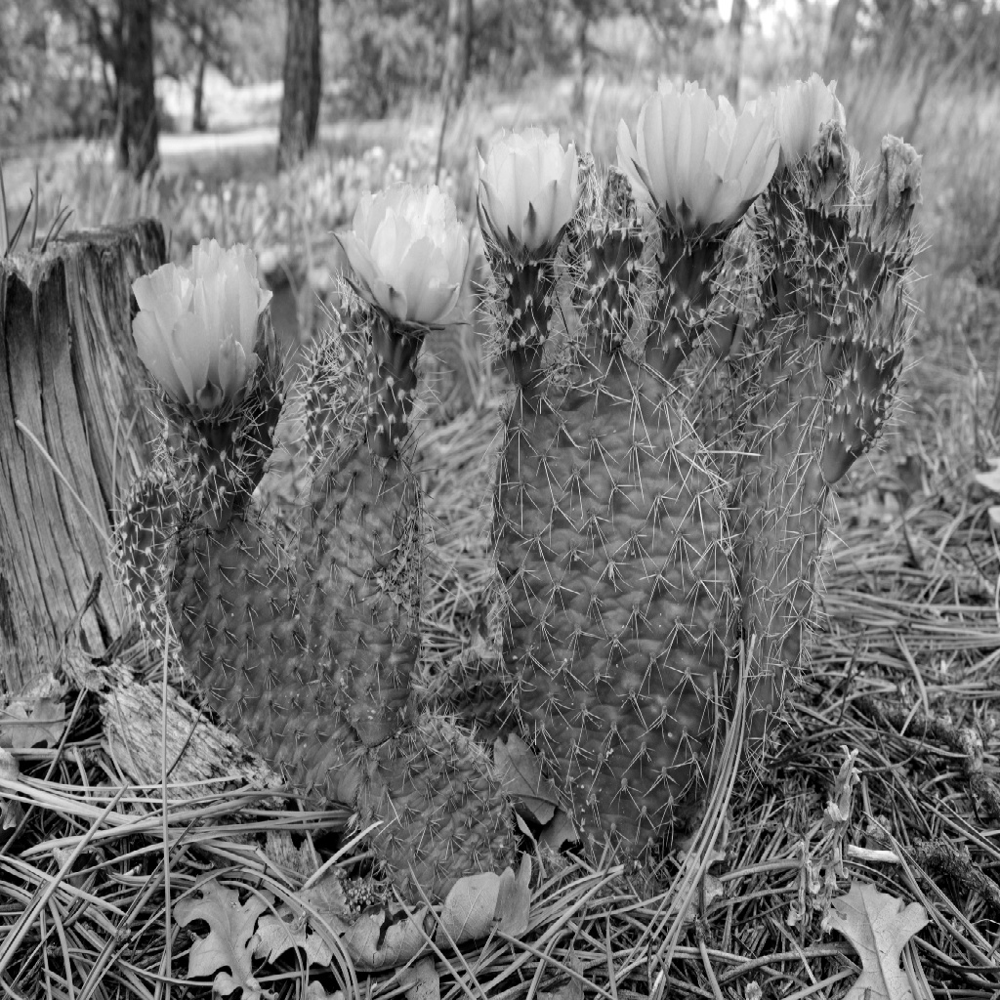

In [124]:
#autoencoded image from the train folder 
imshow(image[0])

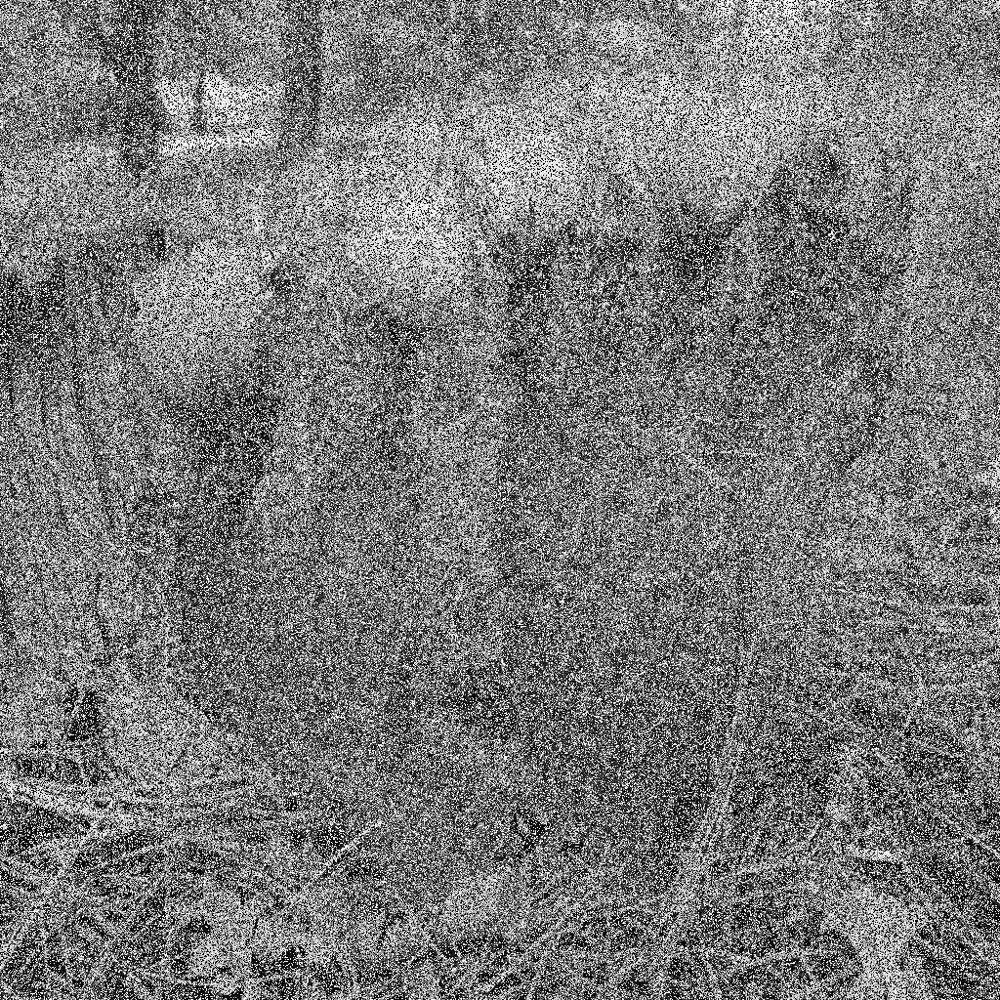

In [125]:
#testing the images in train folder
patches = Noise(ratio=amount)(image)
imshow(patches[0])

In [65]:
if os.path.exists('D:/Interns/upscalepics/'):
    image = tf.keras.preprocessing.image.load_img(image_path, target_size=(image_size, image_size))
    image = tf.keras.preprocessing.image.img_to_array(image)
    image = tf.expand_dims(image, axis=0)

    imshow(image)
else:
    print("The specified image file does not exist.")


error: Unknown C++ exception from OpenCV code

In [190]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
 
def imshow(img):
    import cv2
    import IPython
    import numpy as np
    _,ret = cv2.imencode('.jpg', np.array(img)) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)
    
image_count = 1
image_size = 1024
image_index = 10
amount = 0.5

image = tf.expand_dims(tf.keras.preprocessing.image.img_to_array(
    tf.keras.preprocessing.image.load_img('D:/Interns/upscalepics/test_images_' + os.listdir('D:/Interns/upscalepics/test_images_')[image_index], target_size=(image_size, image_size), color_mode='grayscale')
), axis=0)

IndexError: list index out of range

In [137]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

def imshow(img):
    import cv2
    import IPython
    _, ret = cv2.imencode('.jpg', np.array(img)) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)

image_count = 1
image_size = 1024
image_index = 10
amount = 0.5

# Check the files in the directory
test_image_path = 'D:/Interns/upscalepics/test_images_'
test_images_list = os.listdir(test_image_path)
if len(test_images_list) == 0:
    print("No test images found in the directory.")
elif image_index >= len(test_images_list):
    print("The specified image index is out of range.")
else:
    # Load the test image at the specified index
    test_image_filename = test_images_list[image_index]
    image = tf.expand_dims(tf.keras.preprocessing.image.img_to_array(
        tf.keras.preprocessing.image.load_img(test_image_path + test_image_filename, target_size=(image_size, image_size), color_mode='grayscale')
    ), axis=0)

    # Now you can proceed with the rest of the code to test the model with this image


The specified image index is out of range.


In [228]:
import os
import IPython
import numpy as np
import tensorflow as tf

def imshow(img):
    i = IPython.display.Image(data=img) 
    IPython.display.display(i)

# Replace 'your_test_image.jpg' with the file name of your test image
test_image_filename = 'test_image_2.png'
image_path = 'D:/Interns/upscalepics/test_images_/' + test_image_filename

image_size = 1024

image = tf.keras.preprocessing.image.load_img(image_path, target_size=(image_size, image_size))
image = tf.keras.preprocessing.image.img_to_array(image)
image = tf.expand_dims(image, axis=0)

imshow(image)


In [229]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

def imshow(img):
    import cv2
    import IPython
    _, ret = cv2.imencode('.jpg', np.array(img)) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)

image_count = 1
image_size = 1024
image_index = 10
amount = 0.5

# Check the files in the directory
test_image_path = 'D:/Interns/upscalepics/test_images_/'
test_images_list = os.listdir(test_image_path)
print("Number of test images found:", len(test_images_list))
if len(test_images_list) == 0:
    print("No test images found in the directory.")
elif image_index >= len(test_images_list):
    print("The specified image index is out of range.")
else:
    # Load the test image at the specified index
    test_image_filename = test_images_list[image_index]
    image = tf.expand_dims(tf.keras.preprocessing.image.img_to_array(
        tf.keras.preprocessing.image.load_img(test_image_path + test_image_filename, target_size=(image_size, image_size), color_mode='grayscale')
    ), axis=0)

    # Now you can proceed with the rest of the code to test the model with this image


Number of test images found: 6
The specified image index is out of range.


In [230]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

def imshow(img):
    import cv2
    import IPython
    _, ret = cv2.imencode('.jpg', np.array(img)) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)

image_count = 6
image_size = 1024
image_index = 6
amount = 0.5

# Check the files in the directory
test_image_path = 'D:/Interns/upscalepics/test_images_/'
test_images_list = os.listdir(test_image_path)
print("Number of test images found:", len(test_images_list))

if len(test_images_list) == 0:
    print("No test images found in the directory.")
else:
    print("Test images and their corresponding indices:")
    for i, test_image_filename in enumerate(test_images_list):
        print(i, ":", test_image_filename)

    if image_index >= len(test_images_list):
        print("The specified image index is out of range.")
    else:
        # Load the test image at the specified index
        test_image_filename = test_images_list[image_index]
        image = tf.expand_dims(tf.keras.preprocessing.image.img_to_array(
            tf.keras.preprocessing.image.load_img(test_image_path + test_image_filename, target_size=(image_size, image_size), color_mode='grayscale')
        ), axis=0)

        # Now you can proceed with the rest of the code to test the model with this image


Number of test images found: 6
Test images and their corresponding indices:
0 : test_image_1.png
1 : test_image_2.png
2 : test_image_3.png
3 : test_image_4.png
4 : test_image_5.png
5 : test_image_6.png
The specified image index is out of range.


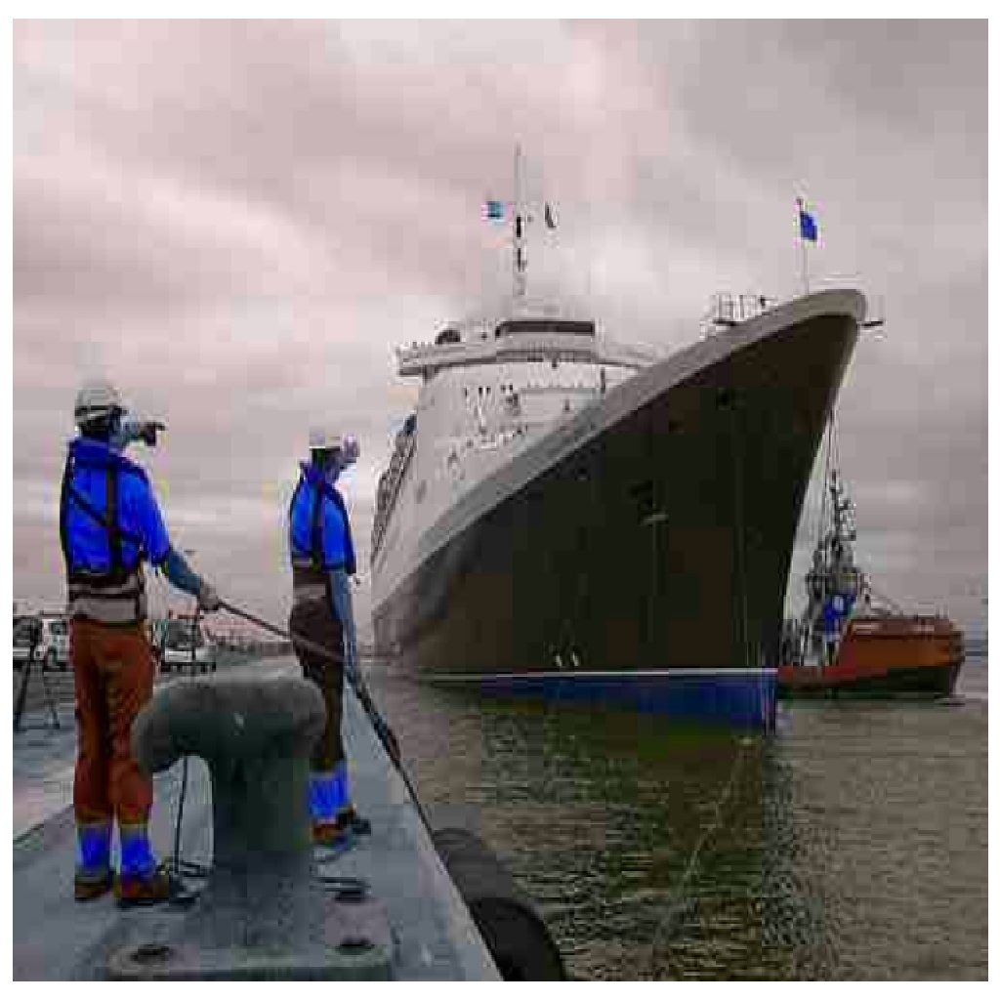

In [231]:
#autoencoded image
imshow(image[0])

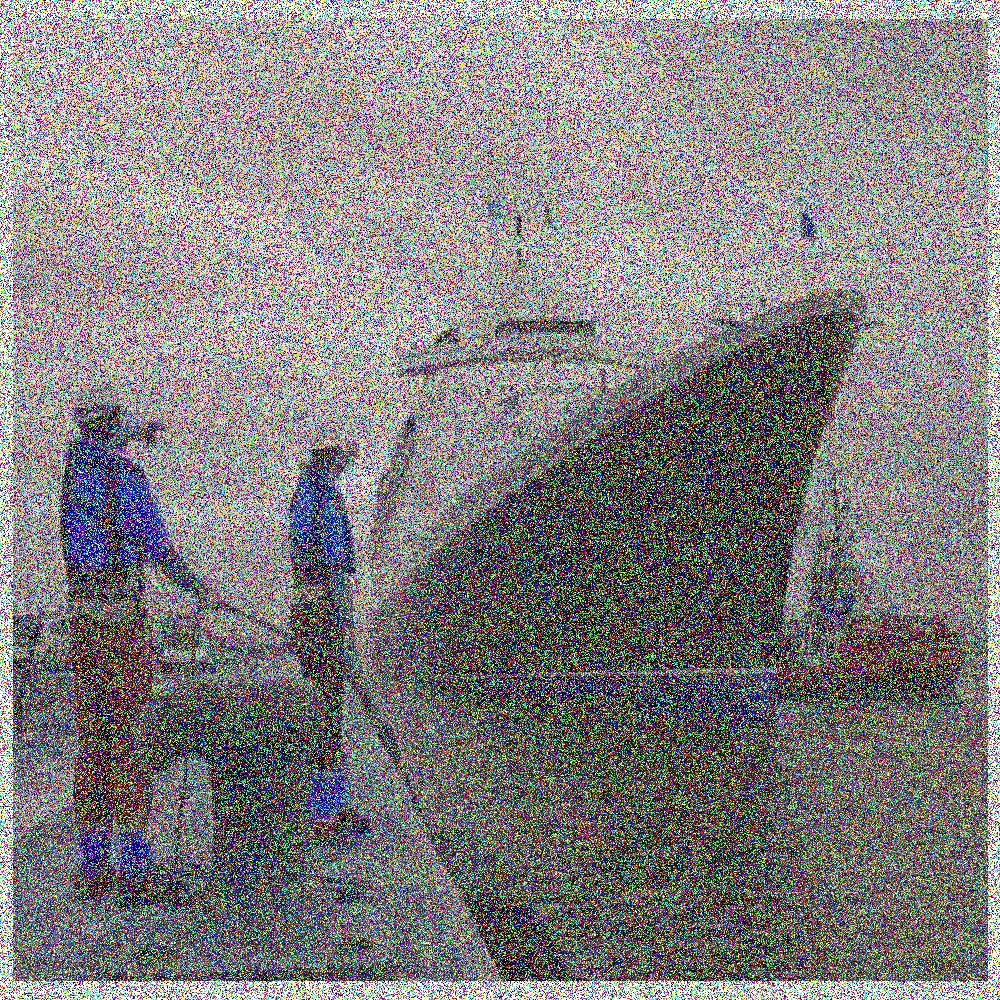

In [232]:
#decoded image 
patches = Noise(ratio=amount)(image)
imshow(patches[0])

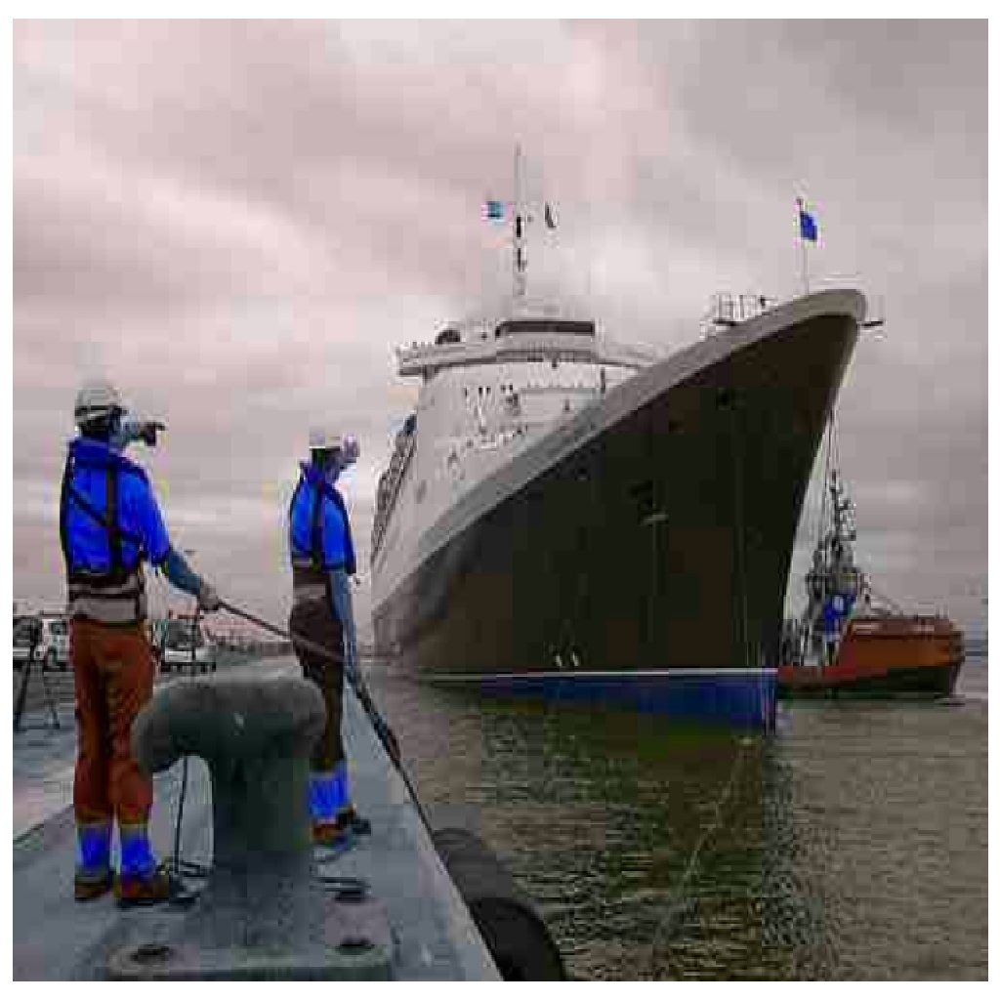

Output image saved at: output_image_2.png


In [233]:

# ... (Previous code to load and preprocess the image)

# Show the image using imshow
imshow(image[0])

# Convert the image from NumPy array to uint8 format for saving
output_image = np.array(image[0], dtype=np.uint8)

# Save the output image using cv2.imwrite
output_image_path = 'output_image_2.png'  # Set the desired output image file path and name
cv2.imwrite(output_image_path, output_image)

# Print a message indicating that the image is saved
print("Output image saved at:", output_image_path)

In [235]:
#converting the obtained autoencoded images to bgr format 
# Function to convert RGB image to BGR format and save
def convert_rgb_to_bgr(input_folder, output_folder):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # List all files in the input folder
    image_files = os.listdir(input_folder)

    for file in image_files:
        # Load the RGB image
        rgb_image_path = os.path.join(input_folder, file)
        rgb_image = cv2.imread(rgb_image_path, cv2.IMREAD_COLOR)

        # Convert to BGR format
        bgr_image = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2BGR)

        # Save the BGR image in the output folder with the same filename
        output_image_path = os.path.join(output_folder, file)
        cv2.imwrite(output_image_path, bgr_image)

        print(f"Converted and saved {file} in BGR format.")

# Set the paths for the input folder (RGB images) and output folder (BGR images)
input_folder_path = 'D:/Interns/upscalepics/Output_test_image'
output_folder_path = 'D:/Interns/upscalepics'

# Convert and save RGB images to BGR format
convert_rgb_to_bgr(input_folder_path, output_folder_path)




Converted and saved output_image_1.png in BGR format.
Converted and saved output_image_2.png in BGR format.
Converted and saved output_image_3.png in BGR format.
Converted and saved output_image_4.png in BGR format.
Converted and saved output_image_5.png in BGR format.
Converted and saved output_image_6.png in BGR format.
